# Feature Improvement - Train Models— Take#02.03

As a result of EDA and Feature Improvements (including data integrity checks, handling missing values, outliers detection) in Previous Iteration <br /> **AUC-ROC boosted from 0.58415of baseline model to 0.85715** as follows

<img src="../../mesc/fixed_missing_values_and_more_features/lr_itr_02.PNG">

## and now the complete process to get above results

## Begin with imports

In [2]:
import imports as ip

%matplotlib inline  
plt.style.use('fivethirtyeight')  # a popular data visualization theme
%load_ext autoreload
%autoreload 2

<IPython.core.display.Javascript object>

In [3]:
dataset_path="../../Datasets/widsdatathon2020/training_v2.csv"
df=pd.read_csv(dataset_path)
df.head()

<IPython.core.display.Javascript object>

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,...,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
0,66154,25312,118,0,68.0,22.73,0,Caucasian,M,180.3,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
1,114252,59342,81,0,77.0,27.42,0,Caucasian,F,160.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Respiratory,Respiratory
2,119783,50777,118,0,25.0,31.95,0,Caucasian,F,172.7,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Metabolic,Metabolic
3,79267,46918,118,0,81.0,22.64,1,Caucasian,F,165.1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
4,92056,34377,33,0,19.0,NaN,0,Caucasian,M,188.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Trauma,Trauma


### Check for explicit missing values
Note : A complete data dictionary has been provided by dataset distributors which needs to be studied in detail in order to explore further dimensions of the data most importantly in the following areas
1. Missing Values being encoded in some other way
2. Even if documentation wasnot provided, we would need to still dig deeper into attributes for insights regarding missing vales. For example, attribute "height" and "bmi" can never be zero! If for such attributes, zero is present, that implies missing values in our data!


In [4]:
ip.vz.plot_missing_pct(df,df.columns)

<Figure size 3600x720 with 0 Axes>

## Insights:
1. There are columns with slightly missing values whereas some have quite a large number of missing values!
2. Dealing with missing values might lead to much higher perforrmance gains provided attribute is a valuable feature!
3. For baseline model, we dropped missing value rows and didnot employ any imputation strategy
4. Dropping missing values depends upon how much data we are left with, and above clearly shows that missing vales must be imputed!

In [5]:
## Lets check how many rows have atleast 1 missing value
print("Total # of rows in dataset : {}".format(df.shape[0]))
print("Data Frame without any missing values : {}".format(df.dropna().shape[0]))
print("Data Frame with >=1 missing value(s) : {}".format(df.shape[0]-df.dropna().shape[0]))

Total # of rows in dataset : 91713
Data Frame without any missing values : 25
Data Frame with >=1 missing value(s) : 91688


### EDA of Data Types Dict Provided

### Insight : By having a quick look over the data types documentation provided, we can have a clear cut indication of what possible values could be present as missing values in the dataset

In [6]:
data_dict_path="../../Datasets/widsdatathon2020/WiDS Datathon 2020 Dictionary.csv"
data_dict_df=pd.read_csv(data_dict_path)
data_dict_df.head()

<IPython.core.display.Javascript object>

,Category,Variable Name,Unit of Measure,Data Type,Description,Example
0,identifier,encounter_id,None,integer,Unique identifier associated with a patient un...,None
1,identifier,hospital_id,None,integer,Unique identifier associated with a hospital,None
2,identifier,patient_id,None,integer,Unique identifier associated with a patient,None
3,demographic,hospital_death,None,binary,Whether the patient died during this hospitali...,0
4,demographic,age,Years,numeric,The age of the patient on unit admission,None


### Check data types category wise

In [7]:
title="Category Wise Distrubtion For Data Types"
ip.vz.plot_cat_bar(data_dict_df,"Category","Data Type",title)

## Reality Check - Check for implicit missing values

### Ensure that missing values are encoded properly as missing i.e NaN to be more precise

1. Categorical : **Nominal Strings** - empty strings/"unknowns"/"?" signify missing values
1. Categorical : **Nominal Booleans**" - there shouldnot be any value apart from booleans and NaNs
2. Numerical : Possible missing values could be encoded as 0's. We need to ensure using above graph that whether a value of 0 is missing for a given variable or a value of 0 is actually a valid value for that variable. This info can be derived from documentation


### check desriptions of pure numerical categories which included

1. Vitals
2. Labs
3. Labs Blood Gas
4. Apache Prediction
5. Gossis Example Prediction

# Analysis Labs, Vitals & Labs Blood Gas Variables

In [8]:
num_types=data_dict_df.Category.value_counts().index
num_types=['labs', 'vitals','labs blood gas',"APACHE prediction"]

### Assumption - Even without any biological domain expertise, values for above 3 variables shouldnot be  zero 

In [9]:
zeros_dict=ip.hf.check_zeros(df,data_dict_df,num_types[:3])


None of the variables in category : 'labs' has any zero values
Total Zero Values For Variable d1_heartrate_min in Category 'vitals' : 598 
Total Zero Values For Variable d1_resprate_min in Category 'vitals' : 3673 
Total Zero Values For Variable d1_spo2_max in Category 'vitals' : 6 
Total Zero Values For Variable d1_spo2_min in Category 'vitals' : 152 
Total Zero Values For Variable h1_resprate_min in Category 'vitals' : 634 
Total Zero Values For Variable h1_spo2_max in Category 'vitals' : 12 
Total Zero Values For Variable h1_spo2_min in Category 'vitals' : 62 

None of the variables in category : 'labs blood gas' has any zero values


In [10]:
pd.set_option('max_colwidth', -1)
data_dict_df[(data_dict_df.Category=="vitals") & (data_dict_df["Variable Name"].isin(list(zeros_dict.keys())))][["Variable Name","Unit of Measure","Description"]]

<IPython.core.display.Javascript object>

,Variable Name,Unit of Measure,Description
54,d1_heartrate_min,Beats per minute,The patient's lowest heart rate during the first 24 hours of their unit stay
62,d1_resprate_min,Breaths per minute,The patient's lowest respiratory rate during the first 24 hours of their unit stay
63,d1_spo2_max,Percentage,The patient's highest peripheral oxygen saturation during the first 24 hours of their unit stay
64,d1_spo2_min,Percentage,The patient's lowest peripheral oxygen saturation during the first 24 hours of their unit stay
88,h1_resprate_min,Breaths per minute,The patient's lowest respiratory rate during the first hour of their unit stay
89,h1_spo2_max,Percentage,The patient's highest peripheral oxygen saturation during the first hour of their unit stay
90,h1_spo2_min,Percentage,The patient's lowest peripheral oxygen saturation during the first hour of their unit stay


### Assumption : Data provided complies to previous 24 hours and the values recorded donot correspond exactly to the time of patient's death. For variables belonging to category **vitals**,  it doesnot make sense for 0 value as heartrate,spo2 & reseprate cant be zeros apart from where hospital_death==1.

In [11]:
arg_dict={"rows":4,"cols":2,"height":1500,"width":1000,"nbins":50}
ip.vz.plot_multiple_plotly(df,list(zeros_dict.keys()),"hospital_death",**arg_dict)

## Above shows that there is general trend of lower values for hospital death = True

## Zooming in for values exactly zero of above variables

In [12]:
zero_columns=list(zeros_dict.keys())
grouped_df=ip.hf.find_zero_outliers(df,zero_columns,cat_col="hospital_death",remove_out=False)
grouped_df

hospital_death,0,1,hospital_death
0,205,393.0,d1_heartrate_min
1,2917,756.0,d1_resprate_min
2,6,0.0,d1_spo2_max
3,104,48.0,d1_spo2_min
4,554,80.0,h1_resprate_min
5,12,0.0,h1_spo2_max
6,61,1.0,h1_spo2_min


In [13]:
arg_dict={"rows":7,"cols":1,"height":2000,"width":1000,"show_legend":False,"plot_type":"box"}
ip.vz.plot_multiple_plotly(df,list(zeros_dict.keys()),"hospital_death",**arg_dict)

In [14]:
arg_dict={"plot_type":"bar","title":"Distribution of 0's with respect to hospital death","barmode":"stack",\
         "height":600,"width":800}
ip.vz.plot_multiple_plotly(grouped_df,[0,1],"hospital_death",**arg_dict)

## Above graph correponds to zero values only. 

1. Abscence of heartrate and hospital_death=0 is suspicious. Other way round though miggt not be always true as this depends when was the last record taken

2. similary, for d1_resprate_min ("The patient's lowest respiratory rate during the first 24 hours of their unit stay - Breaths per minute") having value zero and still having hospital_death=False is suspicious

3. Same goes for other variables

## Such missing 0's values seem to be outliers but this shouldnot affect performance much as there percentage is low - (These zero's are basically signying as misisng values)

In [15]:
grouped_df["pct"]=((grouped_df[0]+grouped_df[1])/float(df.shape[0]))*100
title="Distribution of Missing Values Pct % Vs Attributes having 0's as Missing Values"
ip.vz.count_plot(grouped_df,x="hospital_death",y="pct",matplotlib_use=False,title=title)

<Figure size 3600x720 with 0 Axes>

## General distribution of outliers of above for above variables  

In [16]:
title="Percentage Distribution of Outliers"
arg_dict={"rows":2,"cols":4,"height":700,"width":1000,"show_legend":False,"plot_type":"bar_outliers","title":title}
ip.vz.plot_multiple_plotly(df,list(zeros_dict.keys()),"hospital_death",**arg_dict)

## Check whether 0's are also detected as outliers

In [17]:
out_zero_df=ip.hf.find_zero_outliers(df,zero_columns)
out_zero_df

hospital_death,0,1,hospital_death
0,205,393.0,d1_heartrate_min
1,2917,756.0,d1_resprate_min
2,6,0.0,d1_spo2_max
3,104,48.0,d1_spo2_min
4,554,80.0,h1_resprate_min
5,12,0.0,h1_spo2_max
6,61,1.0,h1_spo2_min


## Matching distribution of 0's of outliers with distribution of zeros in original  dataset 

In [18]:
out_zero_df["Difference in Death = 0"]=grouped_df[0]-out_zero_df[0]
out_zero_df["Difference in Death = 1"]=grouped_df[1]-out_zero_df[1]
out_zero_df

hospital_death,0,1,hospital_death,Difference in Death = 0,Difference in Death = 1
0,205,393.0,d1_heartrate_min,0,0.0
1,2917,756.0,d1_resprate_min,0,0.0
2,6,0.0,d1_spo2_max,0,0.0
3,104,48.0,d1_spo2_min,0,0.0
4,554,80.0,h1_resprate_min,0,0.0
5,12,0.0,h1_spo2_max,0,0.0
6,61,1.0,h1_spo2_min,0,0.0


## Data Issue : Zeros are basically missing values for following cases:

1. Above 7 variables
2. Plus, if these varables have zero values and hospital death == False, only then we are considering them as missing values. 

This indicates that 0's in the dataset are actually missing values. They donot correspond to **actual** missing values

**This suggests that zeros for abobve variables should be properly encoded as "NaNs"

## Lets check % distribution change after proper encodding of 0's as nans

In [19]:
selected_df=df[zero_columns]
corrected_df=df[zero_columns].replace(0,np.nan)
ip.vz.plot_change(selected_df,corrected_df,np.mean,title="Mean % Change Following Proper Encoding of 0's")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,0
d1_heartrate_min,-0.657360
d1_resprate_min,-4.190291
d1_spo2_max,-0.006566
d1_spo2_min,-0.166616
h1_resprate_min,-0.731072
h1_spo2_max,-0.013712
h1_spo2_min,-0.070885


# Feature Improvement — Take#02.02

# Analysis : APACHE Prediction Variables

In [20]:
apache_dict=ip.hf.check_zeros(df,data_dict_df,num_types[3:])
apache_pred_cols=list(apache_dict.keys())

Total Zero Values For Variable apache_4a_hospital_death_prob in Category 'APACHE prediction' : 2488 
Total Zero Values For Variable apache_4a_icu_death_prob in Category 'APACHE prediction' : 9694 


In [21]:
title="Distribution in original dataset"
arg_dict={"rows":2,"cols":1,"height":500,"width":1000,"nbins":25,title:title}
ip.vz.plot_multiple_plotly(df,apache_pred_cols,"hospital_death",**arg_dict)

### Above shows that as prob of death increases:

1. hospital deaths == 1 increase as well
2. hospital deaths == 0 decrease and 
3. Data Issue (incorrect value) : presence of prob as -1 signifies incorrect data (although pct of this is quite less)

## Lets also check distribtion of zeros specifically

In [22]:
apache_pred_cols=list(apache_dict.keys())
grouped_df_apache=ip.hf.find_zero_outliers(df,apache_pred_cols,cat_col="hospital_death",remove_out=False)
grouped_df_apache.rename(columns={0:"original_count_0",1:"original_count_1"},inplace=True)
grouped_df_apache[[0,1]]=grouped_df_apache[["original_count_0","original_count_1"]].apply(np.log)
grouped_df_apache

<IPython.core.display.Javascript object>

hospital_death,original_count_0,original_count_1,hospital_death,0,1
0,2484,4,apache_4a_hospital_death_prob,7.817625,1.386294
1,9675,19,apache_4a_icu_death_prob,9.177301,2.944439


In [23]:
arg_dict={"plot_type":"bar","title":"Apache Prediction Variables : Distribution of Probability exactly 0",
         "height":500,"width":700,"barmode":"stack","yaxis":"log_counts"}
ip.vz.plot_multiple_plotly(grouped_df_apache,[0,1],"hospital_death",**arg_dict)

In [24]:
mask=df[apache_pred_cols]<0
print("................Probabilities Less < 0.............")

print(df[apache_pred_cols][mask][apache_pred_cols[0]].dropna().value_counts())
print(df[apache_pred_cols][mask][apache_pred_cols[1]].dropna().value_counts())


................Probabilities Less < 0.............
-1.0    2371
Name: apache_4a_hospital_death_prob, dtype: int64
-1.0    2230
Name: apache_4a_icu_death_prob, dtype: int64


### type of negative probabilities and their counts in both variables turn out to be almost the same!


## Lets get a quick insight for variables used in previous iteration

1. We do know that for these columns, only pre_icu_los_days is a continous value and we need to check for 0's for this too

In [25]:
previous_cols=["elective_surgery","icu_stay_type","icu_type","pre_icu_los_days",\
               "readmission_status","apache_post_operative"]

## EDA for continous variable

In [26]:
grouped_df_pre_icu=ip.hf.find_zero_outliers(df,[previous_cols[3]],cat_col="hospital_death",remove_out=False)
grouped_df_pre_icu

hospital_death,0,1,hospital_death
0,3333,378,pre_icu_los_days


In [27]:
title="Distribution for Pre_ICU_Los_Days in original dataset"
arg_dict={"rows":1,"cols":1,"height":500,"width":1000,"nbins":50,title:title}
ip.vz.plot_multiple_plotly(df,[previous_cols[3]],"hospital_death",**arg_dict)

## Above also yields negative values which shouldnot be the case as this pre_ice_los_days implies:

The length of stay of the patient between hospital admission and unit admission

In [28]:
print("Total Negative Values For Pre-Ice Los Days: ",np.sum(df.pre_icu_los_days<0))

<IPython.core.display.Javascript object>

Total Negative Values For Pre-Ice Los Days:  778


## EDA for string/categorical variables

1. icu_admit_source
2. icu_admit_type
3. icu_stay_type

In [29]:
cat_list=ip.hf.check_missing_string(df,previous_cols[1:3])


Col : icu_stay_type
Total Sum of Type of Values Present : 91713 & Total Df Shape : (91713, 186)
Categories : 
admit       86183
transfer    4970 
readmit     560  
Name: icu_stay_type, dtype: int64

Col : icu_type
Total Sum of Type of Values Present : 91713 & Total Df Shape : (91713, 186)
Categories : 
Med-Surg ICU    50586
MICU            7695 
Neuro ICU       7675 
CCU-CTICU       7156 
SICU            5209 
Cardiac ICU     4776 
CSICU           4613 
CTICU           4003 
Name: icu_type, dtype: int64


## EDA for Booleans:

1. "elective_surgery"
2. "readmission_status"
3. "apache_post_operative"

In [30]:
arg_dict={"rows":3,"cols":1,"height":800,"width":800,"nbins":20}
ip.vz.plot_multiple_plotly(df,["elective_surgery","readmission_status","apache_post_operative"],"hospital_death",**arg_dict)

#### The case for above is surpirisng for readmission_status column where there is only a single unqiue value in the entire dataset

1. Also note almost the same trend for elective_surgery and apache_post_operative. There is slightly increasing chance of dying when either is false
2. There is less change of dying for false values
3. In case of their true values, the probability to die goes even down even further

## Lets merge all correlations for final one

In [31]:
merged_columns=apache_pred_cols+zero_columns+previous_cols+["hospital_death"]
ip.vz.plot_missing_pct(df,merged_columns)

<Figure size 3600x720 with 0 Axes>

# Correlation Analysis of above variables for 4 types of categories explored and variables from previous iteration 

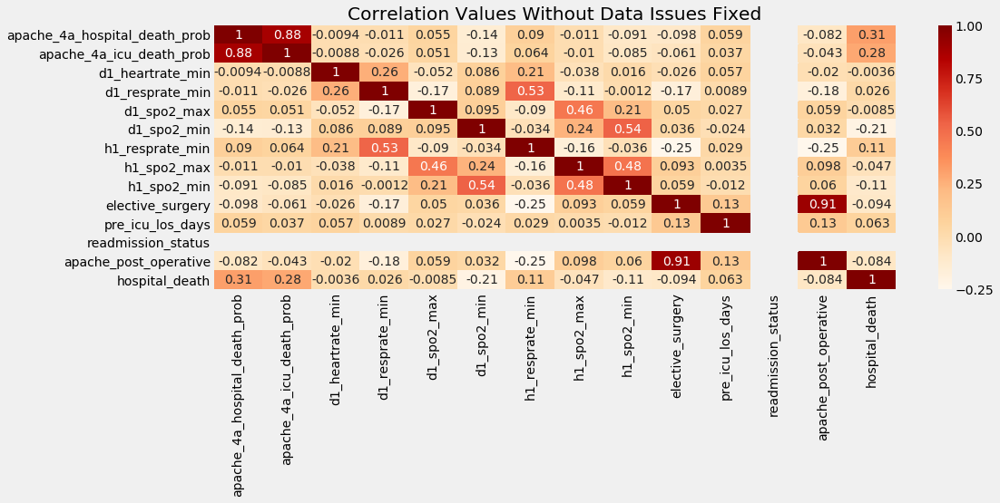

In [32]:
title="Correlation Values Without Data Issues Fixed"
orig_corr=ip.vz.plot_corr(df[merged_columns],title)

#### Another Data Issue : Notice multicollinearity!


## Lets check correlation with data issues of zero's and -1 probs FIXED

<IPython.core.display.Javascript object>

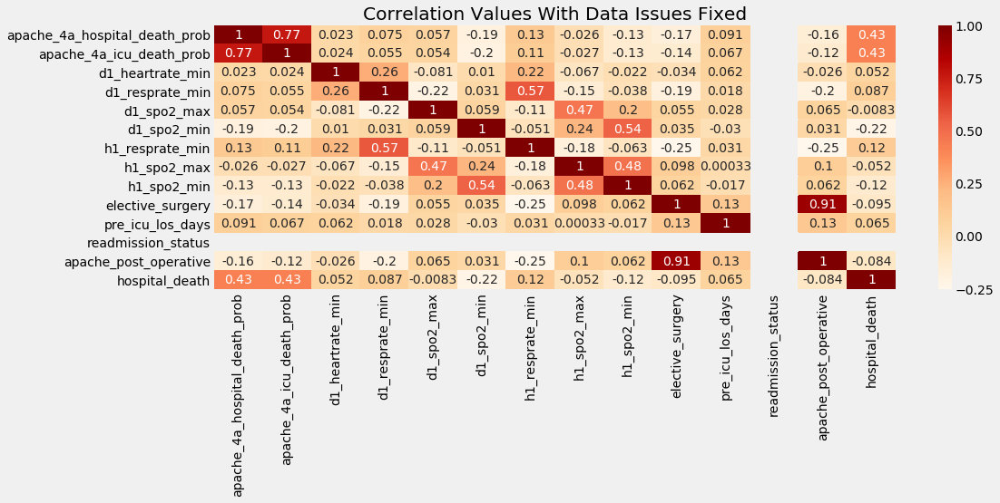

In [33]:
filt_df=df[merged_columns].copy()
filt_df[zero_columns]=filt_df[zero_columns].replace(0,np.nan) #fix 0's as nans
mask=filt_df[apache_pred_cols]>=0 #exclude probs<0
mask=mask.sum(axis=1)>0
filt_df=filt_df[mask]
title="Correlation Values With Data Issues Fixed"
filt_corr=ip.vz.plot_corr(filt_df,title)

In [34]:
filt_df.shape

(81857, 16)

In [35]:
np.sum(filt_df["apache_4a_hospital_death_prob"]==filt_df["apache_4a_icu_death_prob"])/filt_df.shape

<IPython.core.display.Javascript object>

array([1.05427758e-01, 5.39375000e+02])


### There are differences! Correlation values have changed! Lets plot difference for visual ease

## Plotting simple differences yields better results

1. Highly correlated variables end up higher
2. Low correlated donot end up as very high values as evident above

Max Diff Value : 14.207766960914231, Min Diff Value : -11.11346612368308
14.707766960914231


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

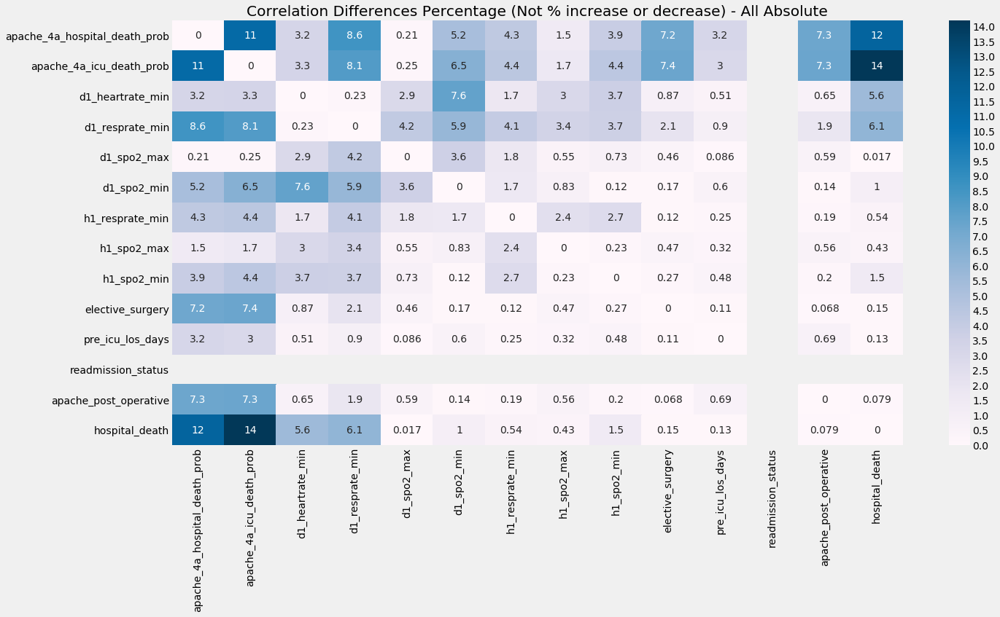

In [36]:
diff_corr=((filt_corr-orig_corr)*100)
diff_max=diff_corr.max().max()
diff_min=diff_corr.min().min()
print("Max Diff Value : {}, Min Diff Value : {}".format(diff_max,diff_min))
title="Correlation Differences Percentage (Not % increase or decrease) - All Absolute"
step=0.5
print(diff_max+step)
cbar_kws={'ticks': np.arange(0,diff_corr.abs().max().max()+step,step,dtype=np.float)}
pct_diff_corr=ip.vz.plot_corr(diff_corr.abs(),title=title,compute_corr=False,color_scheme="PuBu",figsize=(20,10),**cbar_kws)#diff_corr=((filt_corr/orig_corr))

# Lets train models for above data issues fixed and unfixed!

# Feature Improvement Training Models — Take#02.03

In [37]:
merged_columns.remove("readmission_status")

In [38]:
most_corr=filt_corr["hospital_death"]
most_corr[most_corr.abs()>0.05].index

Index(['apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob',
       'd1_heartrate_min', 'd1_resprate_min', 'd1_spo2_min', 'h1_resprate_min',
       'h1_spo2_max', 'h1_spo2_min', 'elective_surgery', 'pre_icu_los_days',
       'apache_post_operative', 'hospital_death'],
      dtype='object')

## Training models with above different configs

In [39]:
most_corr=filt_corr["hospital_death"]
pred_col="hospital_death"
most_corr=most_corr[most_corr.abs()>0.05].index
previous_cols=["elective_surgery","icu_stay_type","icu_type","pre_icu_los_days",\
               "readmission_status","apache_post_operative"]+["hospital_death"]
train_dfs=[[df[merged_columns],"Unfixed",merged_columns[:-1]],\
           [filt_df,"Fixed",merged_columns[:-1]],\
           [df[previous_cols],"Previous Iteration",previous_cols],
          [filt_df[most_corr],"Most Correlated",most_corr]]
model_dict,model_df=ip.hf.train_models(train_dfs,df.shape[0],pred_col,data_dict_df)

(59651, 15)
Fit Success
Test Set Transformation Done (19884, 15)

 ******** roc_auc : 0.8378198053473465 ********
(59651, 15)
Fit Success
Test Set Transformation Done (19884, 15)

 ******** roc_auc : 0.8496512037813979 ********
(58767, 21)
Fit Success
Test Set Transformation Done (19590, 21)

 ******** roc_auc : 0.84247261663286 ********
(57810, 16)
Fit Success
Test Set Transformation Done (19271, 16)

 ******** roc_auc : 0.8608306259857312 ********
(57810, 16)
Fit Success
Test Set Transformation Done (19271, 16)

 ******** roc_auc : 0.8596775364014376 ********
(55135, 22)
Fit Success
Test Set Transformation Done (18379, 22)

 ******** roc_auc : 0.8462656413952079 ********
(13581, 12)
Fit Success
Test Set Transformation Done (4527, 12)

 ******** roc_auc : 0.6891965129893615 ********
(13581, 12)
Fit Success
Test Set Transformation Done (4527, 12)

 ******** roc_auc : 0.7199793732782 ********
(14578, 13)
Fit Success
Test Set Transformation Done (4860, 13)

 ******** roc_auc : 0.68786404

Stats For Best Model...... : Fixed Collinearity Removed Without Highest Correlation
AUC_ROC : 0.8608306259857312 
Original Rows & Columns : (81857, 10) 
Unique Rows & Columns: (77081, 10) 
% of Original Dataset For Training & Testing : 84% 


<Figure size 3600x720 with 0 Axes>

### Test set predictions for Kaggle

## note that test dataset should be processed in the same way as per the insights revealed above!

In [40]:
model_name="Fixed Collinearity Removed Without Highest Correlation"
feats_model=model_dict[model_name]["feats"]
model=model_dict[model_name]["model"]
test_path="../../Datasets/widsdatathon2020/unlabeled.csv"
df_test=pd.read_csv(test_path)
orig_test=df_test
df_test=df_test.copy()

<IPython.core.display.Javascript object>

## notice the distribution of missing values before and after fixing them and then feeding into model!

## lets fix as per EDA

In [41]:
df_test[zero_columns]=df_test[zero_columns].replace(0,np.nan) #fix 0's as nans
df_test["apache_4a_hospital_death_prob"]=df_test["apache_4a_hospital_death_prob"].replace(-1,0) #fix negatives as 0's
print(df_test[feats_model].isna().sum())

<IPython.core.display.Javascript object>

apache_4a_hospital_death_prob    5178
d1_heartrate_min                 424 
d1_spo2_min                      239 
h1_resprate_min                  2430
elective_surgery                 0   
icu_stay_type                    0   
icu_type                         0   
pre_icu_los_days                 0   
readmission_status               0   
dtype: int64


### plot  change

In [42]:
diff_df=ip.vz.plot_change(orig_test[feats_model],df_test[feats_model],np.mean,title="Mean % Change Following Fixage of Data Issues")

<IPython.core.display.Javascript object>

In [58]:
unique_test_set=df_test.drop_duplicates(subset=feats_model,keep=False)
print("Total Test Set Shape: {}".format(orig_test.shape[0]))
print("Actual Values of Test being Predicted : {}".format(unique_test_set.shape[0]))
print("% of Unique Test being Predicted : {}".format(unique_test_set.shape[0]/orig_test.shape[0]))

Total Test Set Shape: 39308
Actual Values of Test being Predicted : 39296
% of Unique Test being Predicted : 0.9996947186323395


### For the time being, lets replace missing values with zero's (NOT ADVISABLE AT ALL & WE WILL DEAL WITH IMPUTATION OF MISSING VALUES IN LATER ITERATION) by mean

## bechmark above with previous iteration findings

In [81]:
model_name="Previous Iteration Collinearity Retained"
feats_model=model_dict[model_name]["feats"]
model=model_dict[model_name]["model"]
df_test=pd.read_csv(test_path)
orig_test=df_test.shape
df_test=df_test.copy()
unique_test_set=df_test.drop_duplicates(subset=feats_model,keep=False)
error,y_preds,y_scores=model.predict(df_test=df_test,model_name="Iteration#01_lr.csv")

<IPython.core.display.Javascript object>

Test Set Transformation Done (39308, 13)
Predictions Generated & Saved : ../../predictions/Iteration#01_lr.csv


<img src="../../mesc/fixed_missing_values_and_more_features/lr_itr_01_baseline.PNG">

### Class Imbalance  - Yet Another Issue to be tackled later !

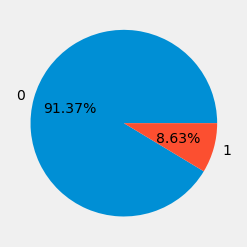

In [83]:
ip.vz.plot_pie(df,"hospital_death","Class Distribution") #plt.plot(kind="pie",data=df["hospital_death"])